# Henan extreme rain of 2021-07-20: MERRA2 depictions, GFS predictions

## Brian Mapes, University of Miami 
### March 1, 2022 
#### Seminar at Beijing University
-------------------

<a id='Outline'></a>

# Outline

## 1. Published case summary, and satellite precipitation estimates (IMERG - GPM product) 

## 2. MERRA2 reanalysis depiction at ~1 degree resolution [jump](#MERRA2)

## 3. Causes: Low levels? Upper levels? Clues from GFS [jump](#GFS)

## 4. Full GFS lead-time ensemble [jump](#GFSleadtimes)

## 5. Conclusions and caveats: extreme-event attribution, outlooks vs. warnings [jump](#conclusions)

--------------


#### 20.7 or 21.7? 

"In this study, we investigate the climate attribution of the 21∙7 Henan extreme" (Han Qin et al. 2022 manuscript) 
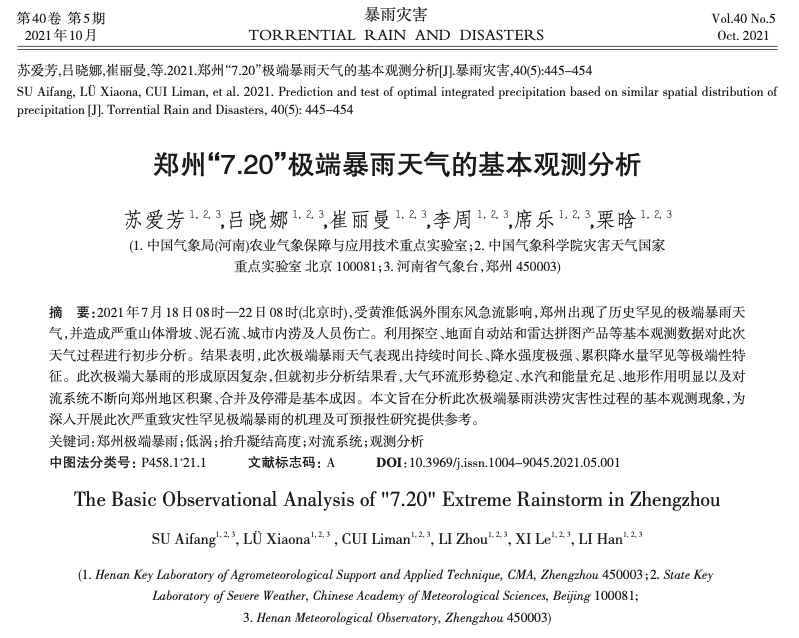

## Abstract: 

### Affected by the easterly jet around the Huang-Huai vortex, extreme rainstorm occurred in Zhengzhou from 08∶00 BT 18 to 08∶00 BT 22 July 2021, and caused serious landslides, mudslides, urban waterlogging and casualties. ... long duration of heavy rainfall, large accumulated rainfall, outstanding extremes, and strong short-term rainfall. The reasons for the extreme heavy rain are complicated. ... basic causes are *stable atmospheric circulation, sufficient water vapor and energy, terrain effect obviously and the convective systems that continuously accumulated, merged and stagnated in Zhengzhou*. This study ... lays the foundation for further in-depth study on the mechanism and predictability of this rare extreme rainstorm.



# BT = UTC+8 

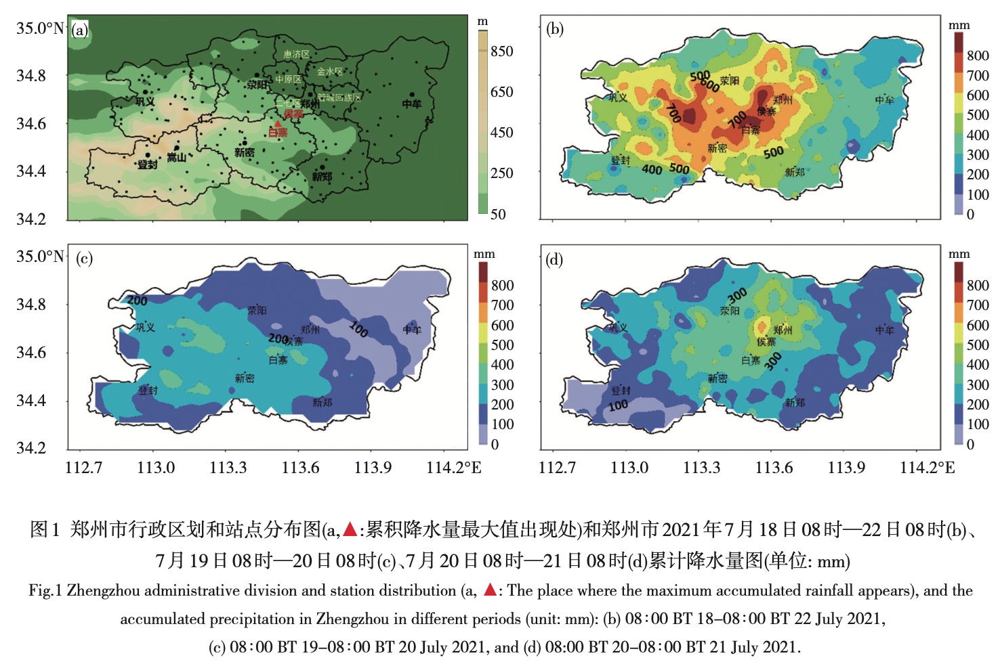

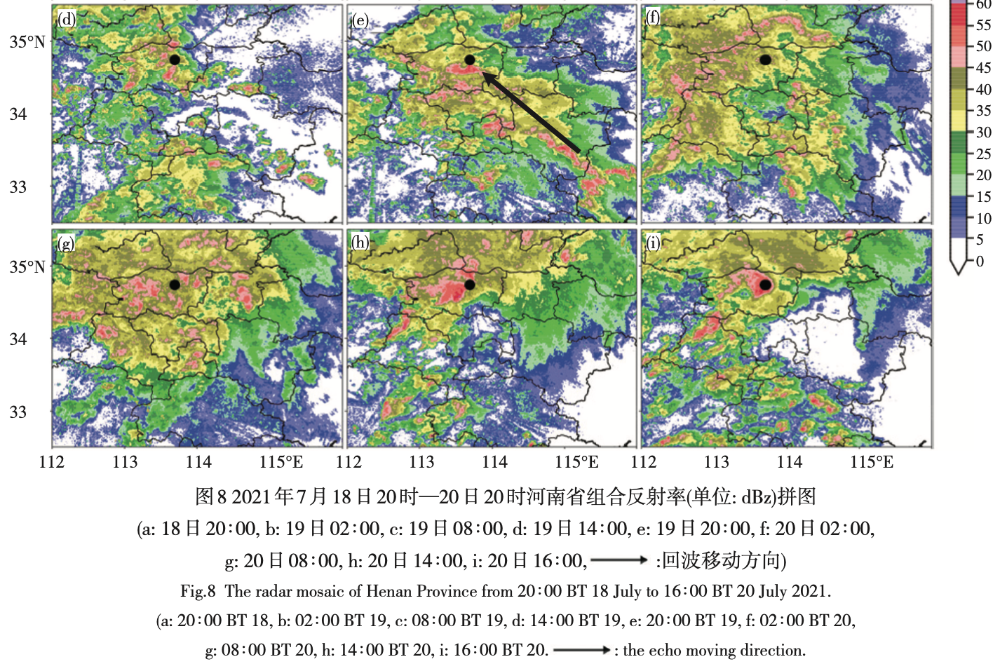

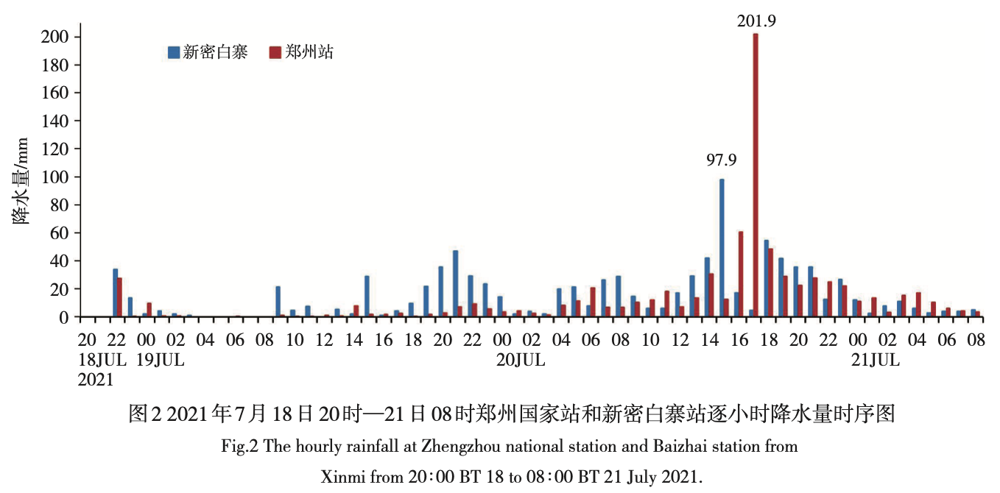

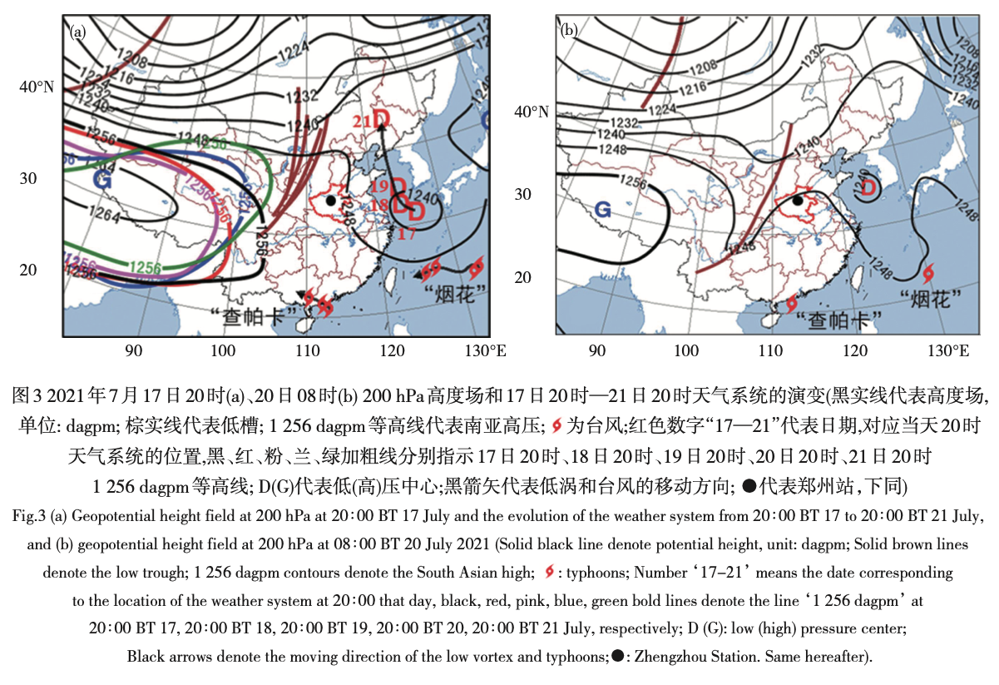

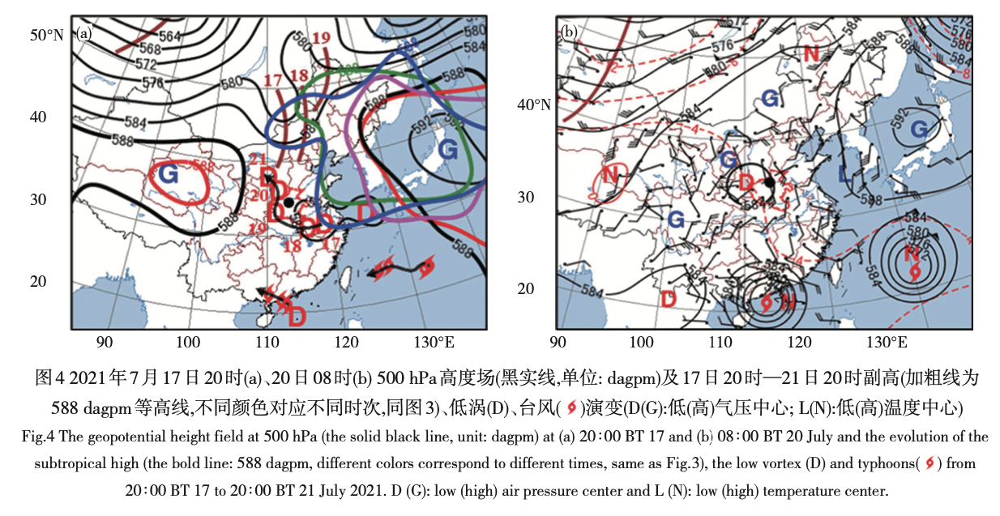

In [ ]:
#pip install ipyidv    #notebook logger for IDV

# launch it 
%reload_ext ipyidv

## IMERG (GPM) rainrate at 2021-07-20 00UTC: 

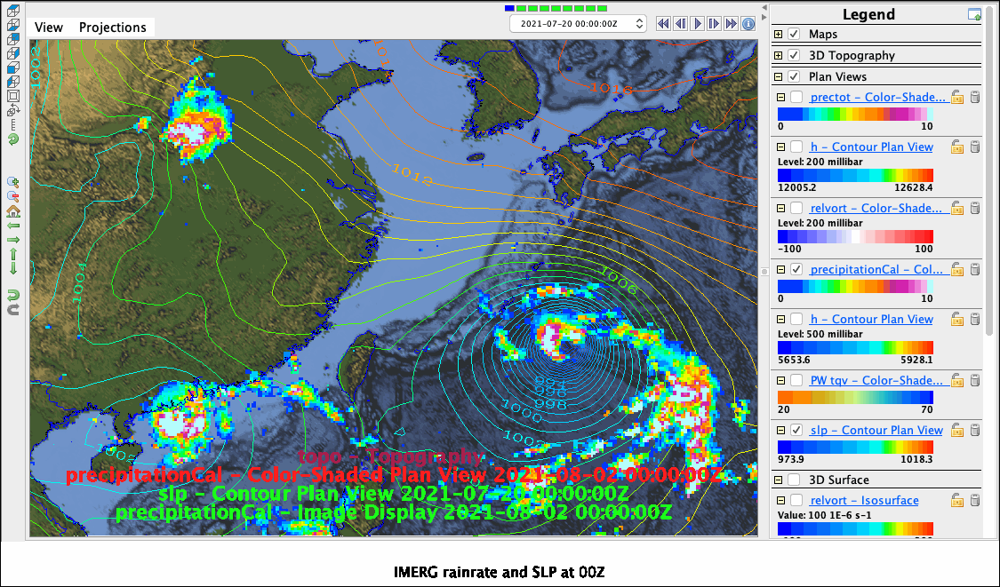

In [2]:
# # %make_image -capture legend -caption 'IMERG rainrate and SLP at 00Z'

------------------

[Back to Outline](#Outline)

<a id='MERRA2'></a>

## How is it depicted in MERRA2 reanalysis? rainrate:  


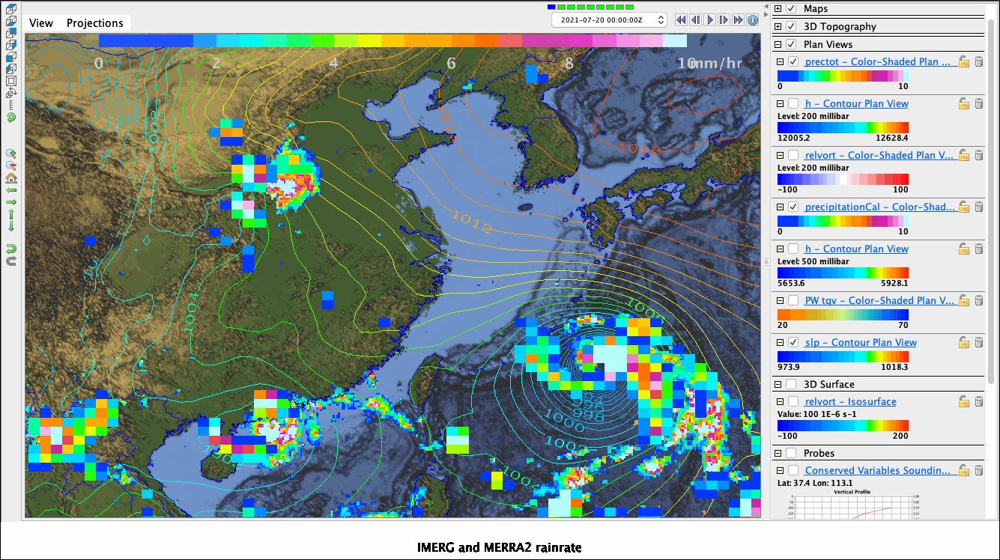

In [7]:
# # # %make_image -capture legend -caption 'IMERG and MERRA2 rainrate'

## A closer look, with topography:

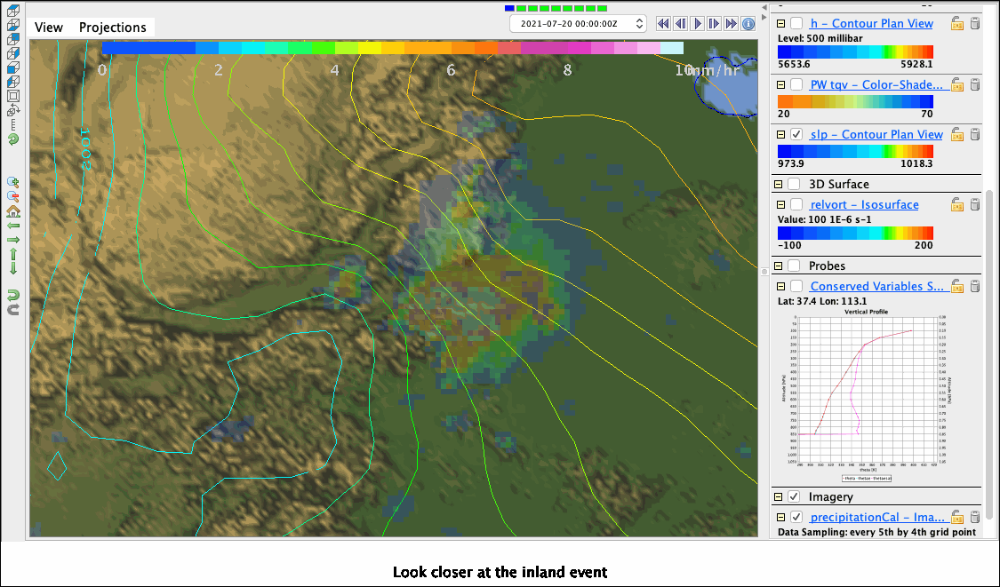

In [5]:
# # %make_image -capture legend -caption 'Look closer at the inland event'

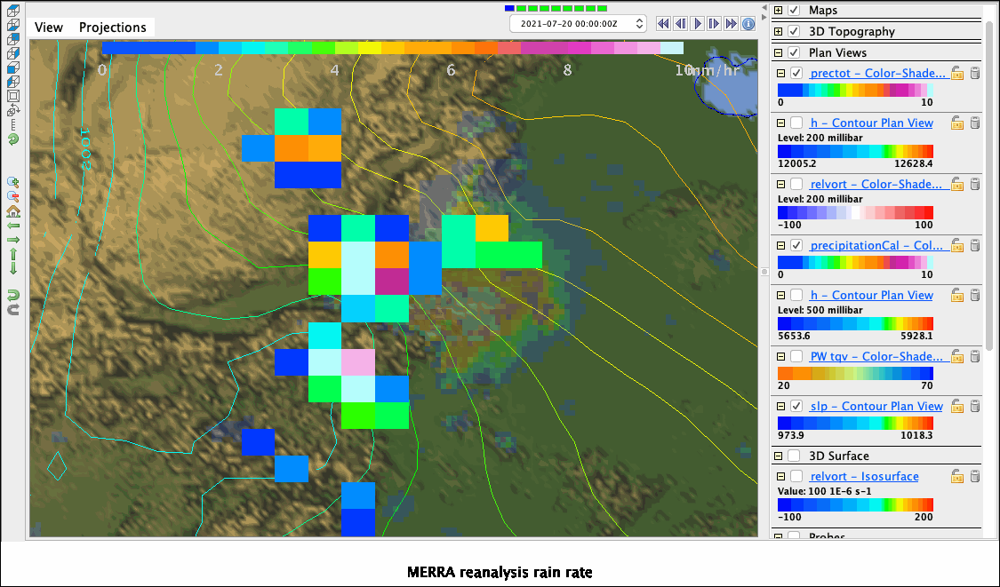

In [6]:
# # %make_image -capture legend -caption 'MERRA reanalysis rain rate'

## MERR2's rain peaked 24h later, actually (2021-07-21 00UTC)
### Low-level flow from east (SLP and PW):

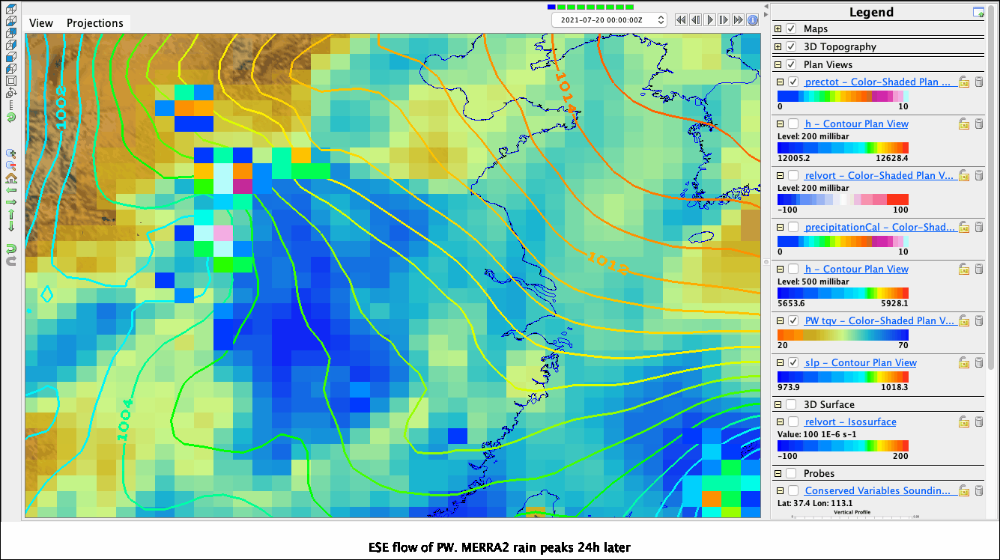

In [8]:
# # %make_movie -capture legend -caption 'ESE flow of PW. MERRA2 rain peaks 24h later'

## M2's 07-21 event:  200 hPa sharp trough, and (model artifact) gridscale thickness anomaly: 

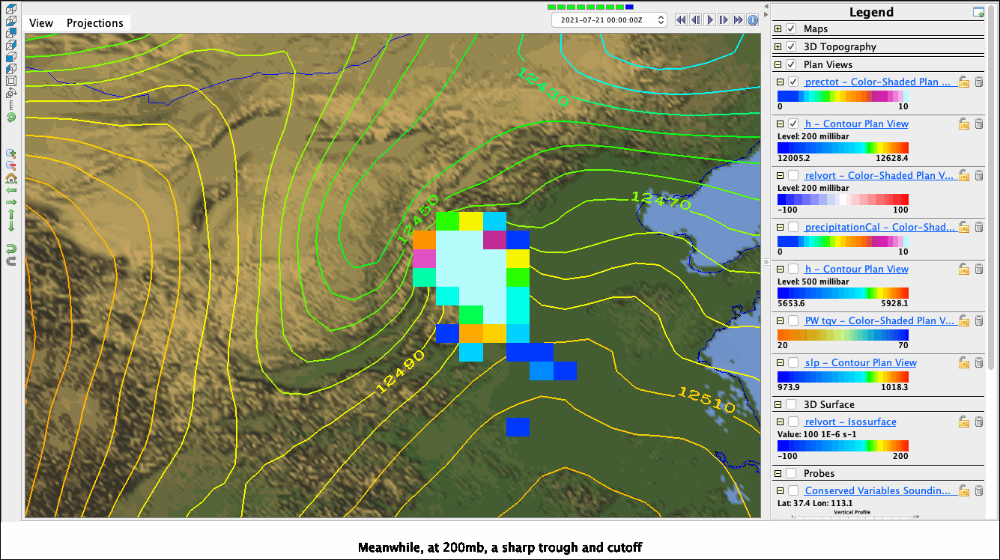

In [10]:
# # %make_image -capture legend -caption 'Meanwhile, at 200mb, a sharp trough and cutoff'

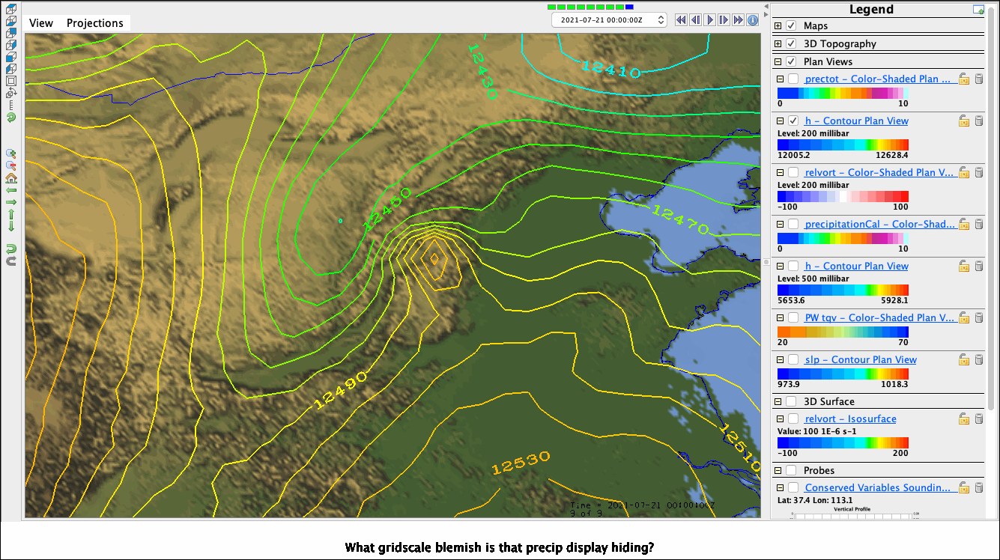

In [15]:
# # %make_image -capture legend -caption 'What gridscale blemish is that precip display hiding?'

## 200 hPa trough: where did the vorticity or PV come from? 

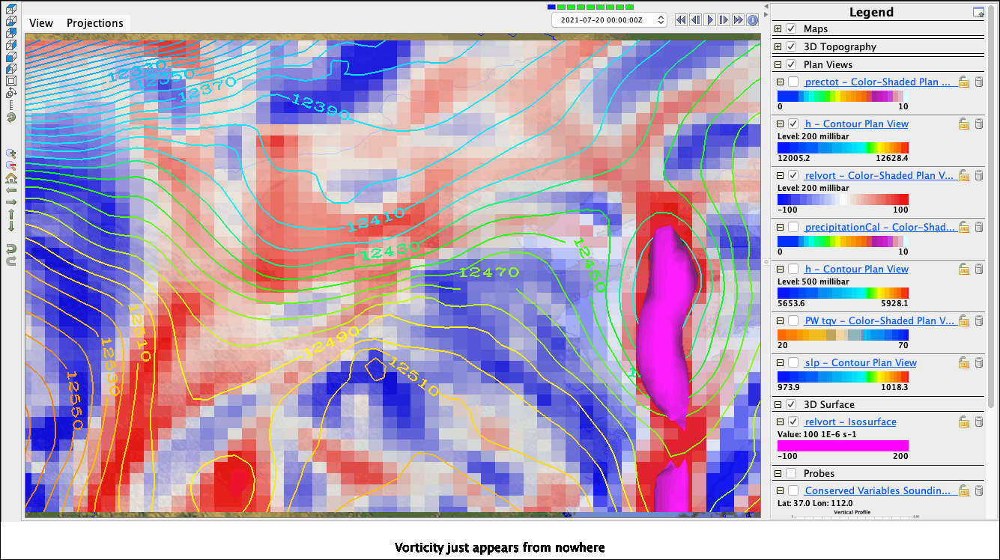

In [16]:
# # %make_movie -capture legend -caption 'Vorticity just appears from nowhere'

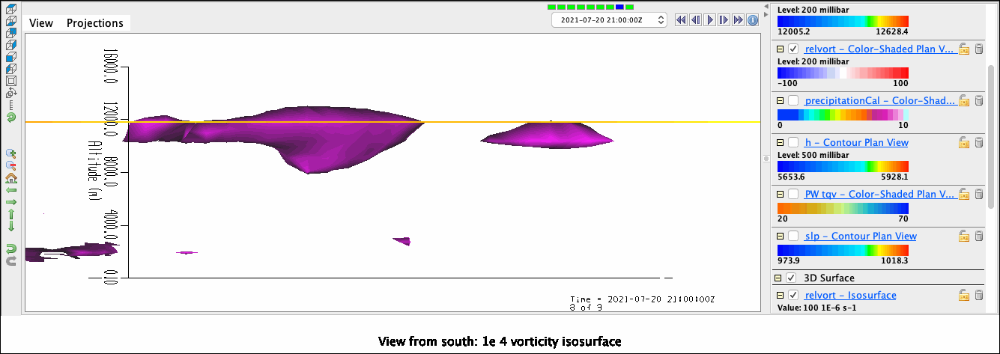

In [17]:
# # %make_image -capture legend -caption 'View from south: 1e-4 vorticity isosurface'

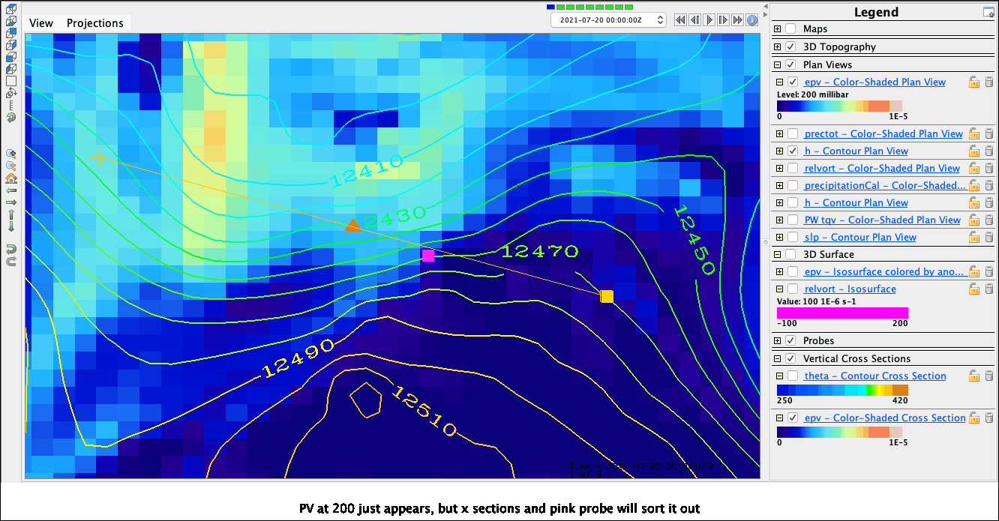

In [20]:
# # %make_movie -capture legend -caption 'PV at 200 just appears, but x-sections and pink probe will sort it out'

## EPV: conserved, so it must be descending from the stratosphere, right?

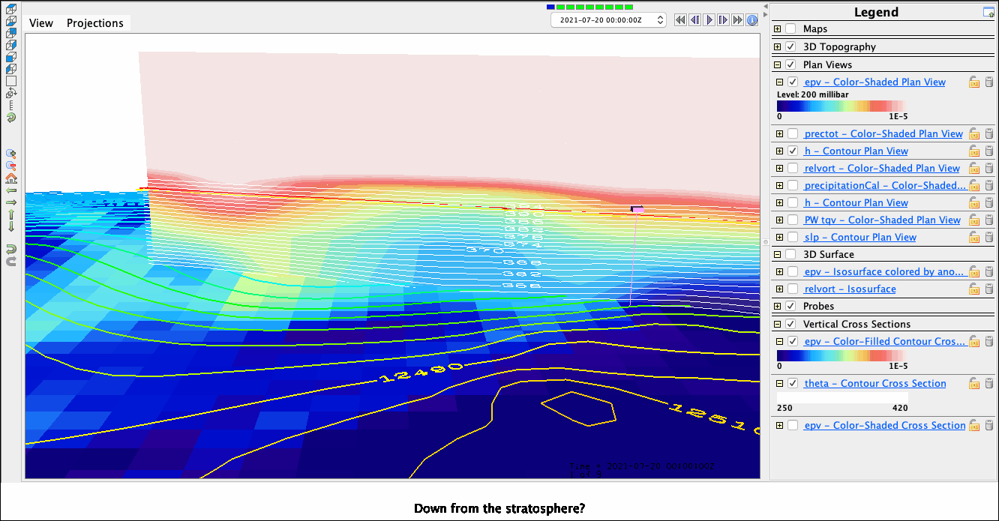

In [22]:
# # %make_movie -capture legend -caption 'Down from the stratosphere?'

## Tropopause (3PVU surface) descends to 10km: 

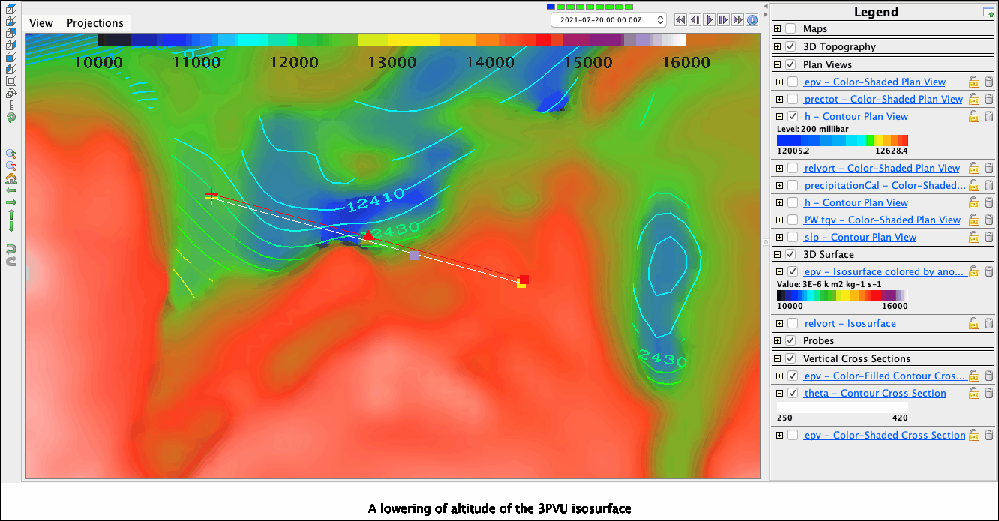

In [24]:
# # %make_movie -capture legend -caption 'A lowering of altitude of the 3PVU isosurface'

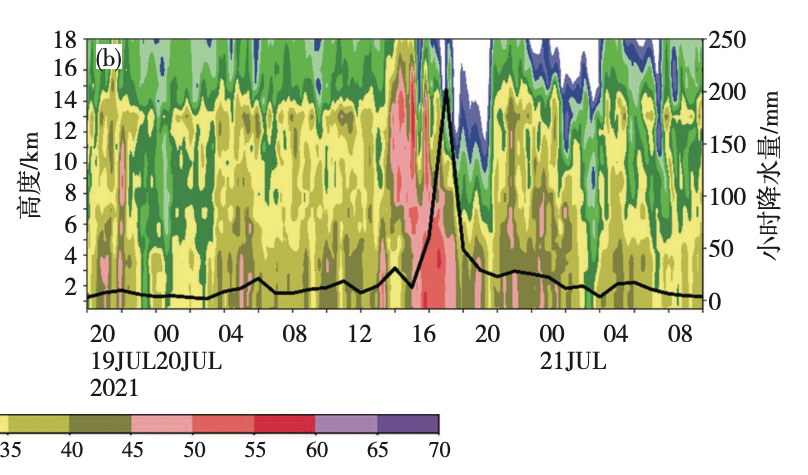

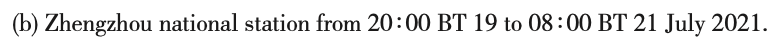

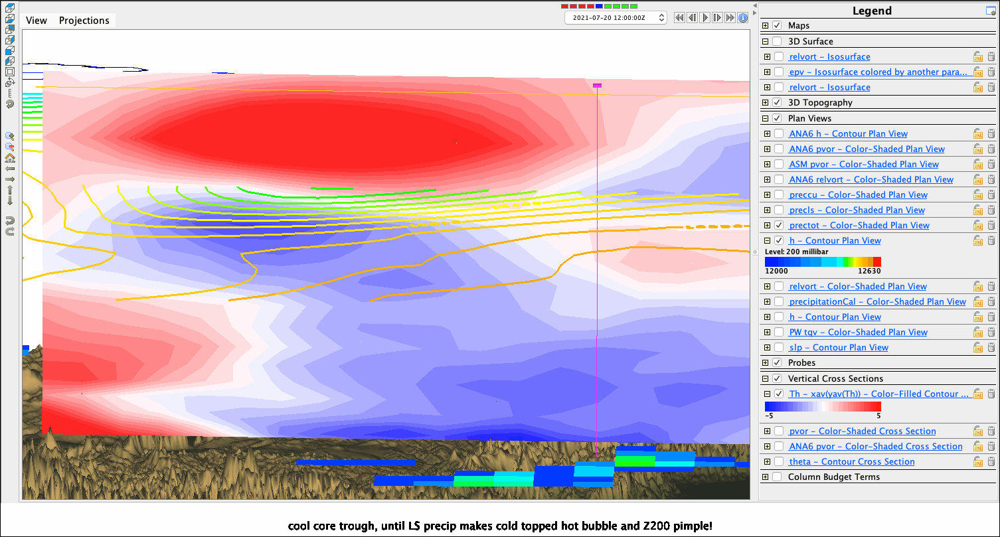

In [11]:
# # %make_movie -capture legend -caption "cool-core trough, until LS precip makes cold-topped hot bubble and Z200 pimple!"

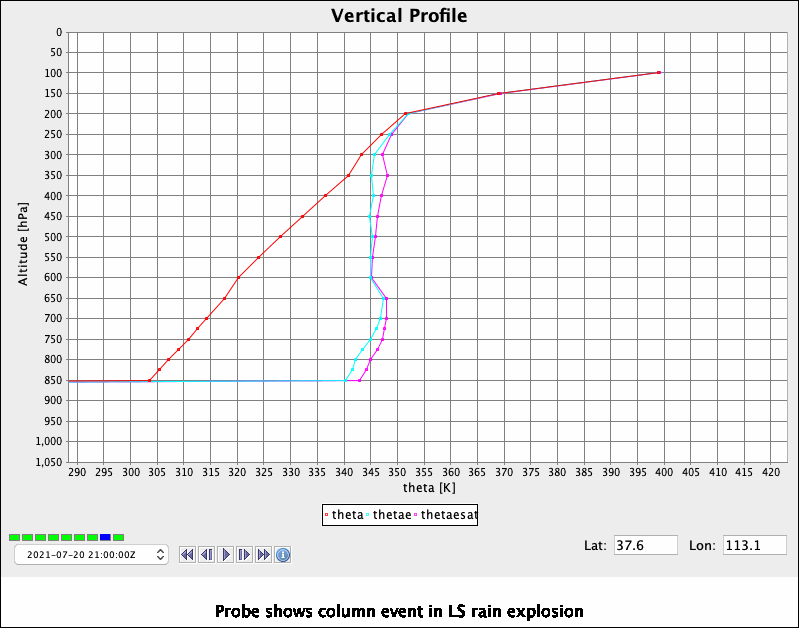

In [7]:
# # %make_image -capture legend -display probe -caption "Probe shows column event in LS rain explosion"

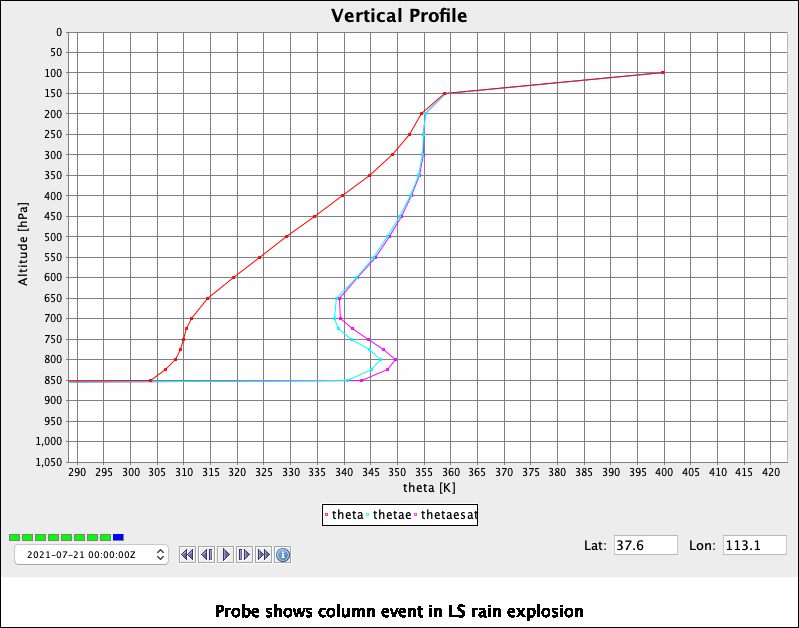

In [8]:
# # %make_image -capture legend -display probe -caption "Probe shows column event in LS rain explosion"

# That big MERRA2 grid-scale rain event also induces low-level  $\zeta_{rel} > 10^{-4} s^{-1}$ briefly:

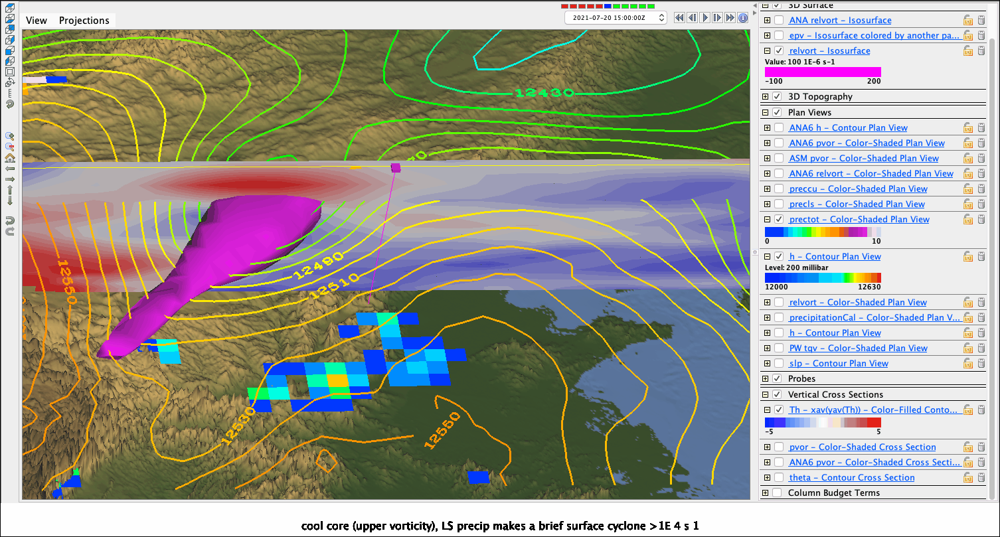

In [18]:
# # %make_movie -capture legend -caption "cool-core (upper vorticity), LS precip makes a brief surface cyclone >1E-4 s-1"

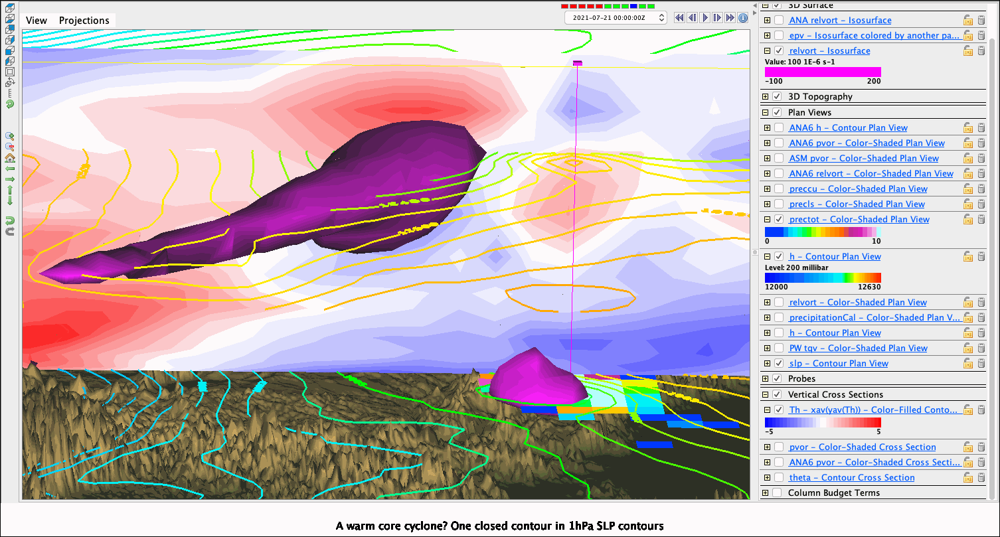

In [19]:
# # %make_image -capture legend -caption "A warm core cyclone? One closed contour in 1hPa SLP contours"

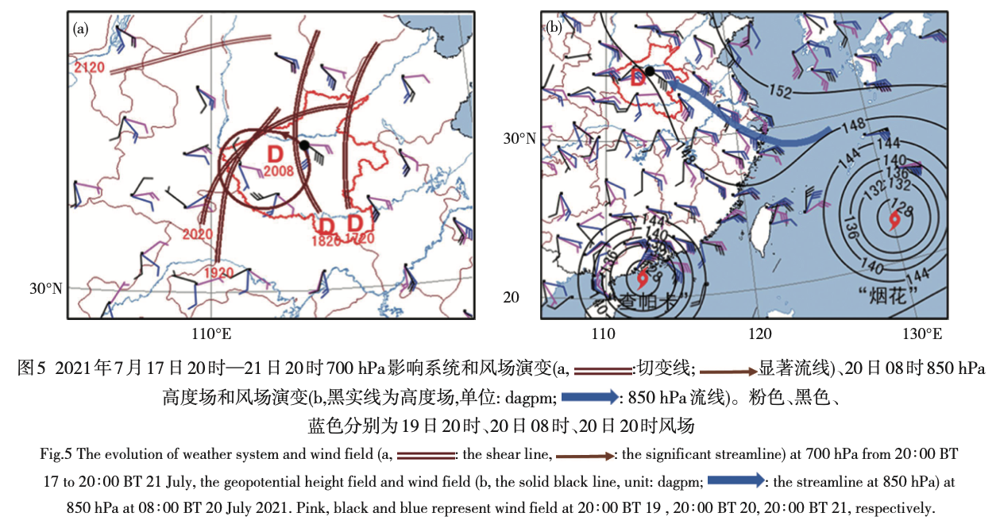

----------------------
------------------
<a id='GFS'></a>

# Questions: 
## If M2 was 24h late, forcing must have been intense and sustained
## Yet also focused (or is the mesoscale a naturally emerging scale?) 
## Was it predictable? (predicted by GFS?)  
## 
[Back to Outline](#Outline)

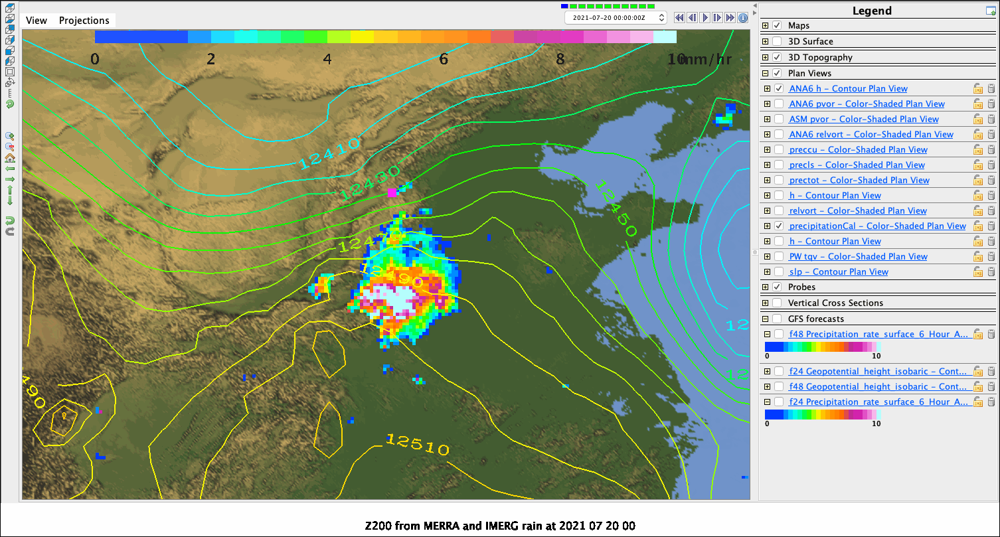

In [22]:
# # %make_image -capture legend -caption "Z200 from MERRA and IMERG rain at 2021-07-20-00"

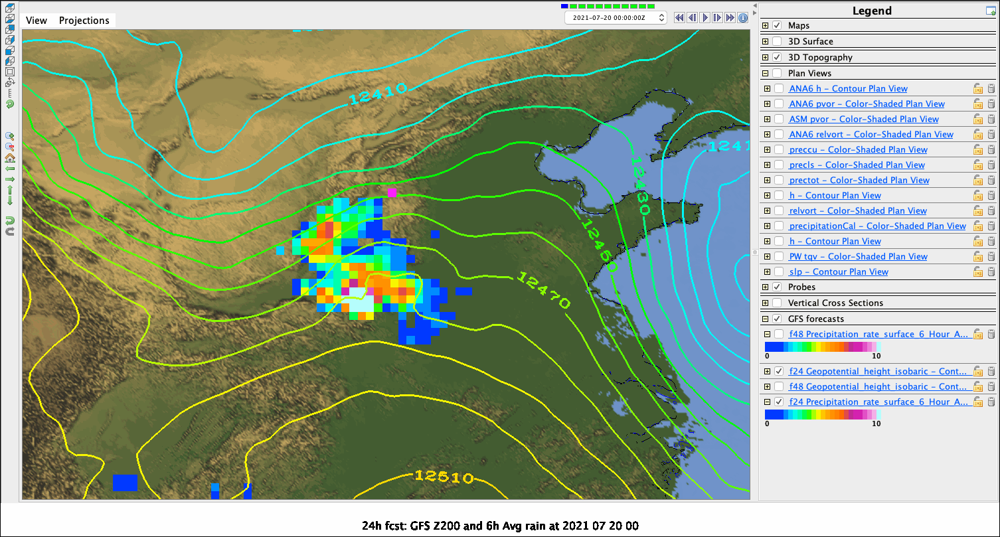

In [24]:
# # %make_image -capture legend -caption "24h fcst: GFS Z200 and 6h Avg rain at 2021-07-20-00"

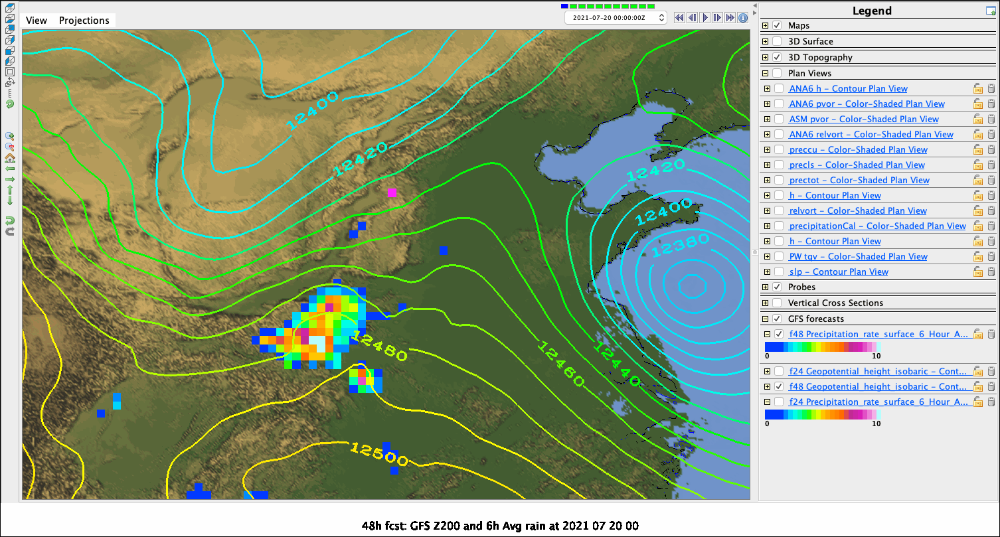

In [25]:
# # %make_image -capture legend -caption "48h fcst: GFS Z200 and 6h Avg rain at 2021-07-20-00"

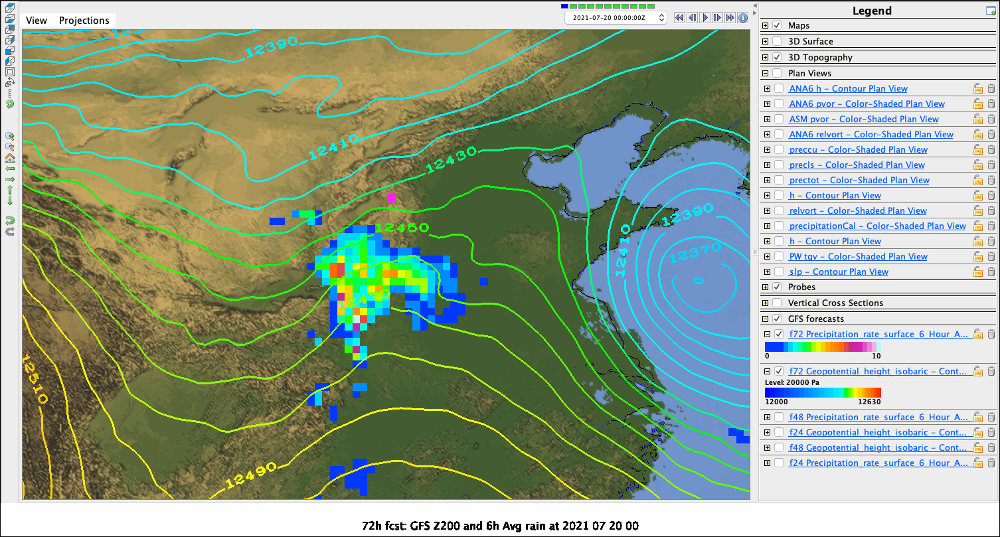

In [26]:
# # %make_image -capture legend -caption "72h fcst: GFS Z200 and 6h Avg rain at 2021-07-20-00"

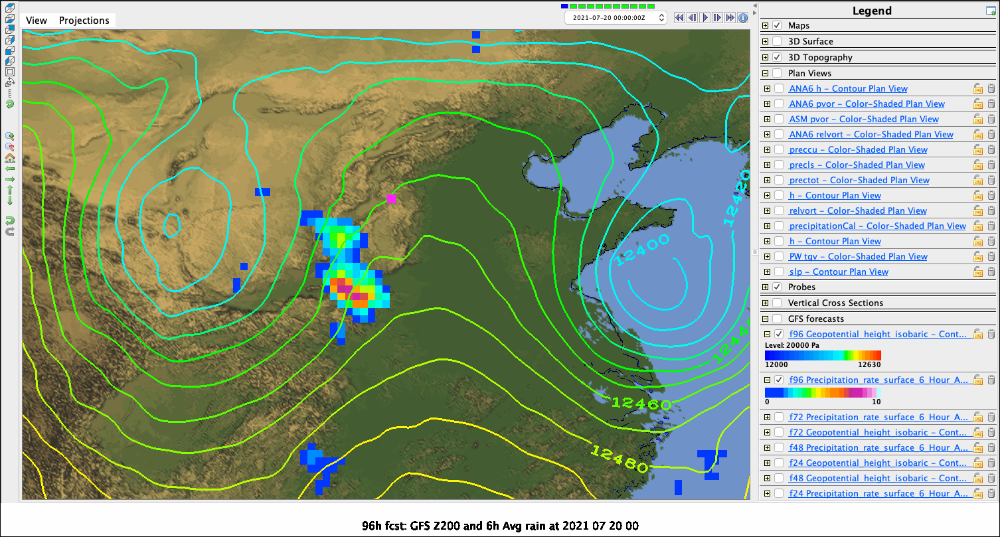

In [27]:
# # %make_image -capture legend -caption "96h fcst: GFS Z200 and 6h Avg rain at 2021-07-20-00"

------------------
<a id='GFSleadtimes'></a>

# Same verification time, an ensemble of lead times 
field = Total_precipitation_surface_6_Hour_Accumulation

[Back to Outline](#Outline)

In [1]:
# Current weather example: Best Time Series as an xarray file 
#from siphon.catalog import TDSCatalog
#cat = TDSCatalog('https://thredds.ucar.edu/thredds/catalog/grib/NCEP/GFS/Global_0p25deg/catalog.xml') ## Best Time Series (current weather) 
#xds = cat.datasets['Best GFS Quarter Degree Forecast Time Series'].remote_access(use_xarray=True)
#xds


3


In [6]:
import datetime
import xarray as xr 
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

# Verification time: 
vtime = datetime.datetime(2021,7,21)

# Loop over 6-hourly initializations 
# https://rda.ucar.edu/thredds/catalog/files/g/ds084.1/2021/20210719/catalog.html

first=True # set a flag for the loop to overwrite

for lead in range(7*24,6,-6): 
    init = vtime - datetime.timedelta(hours=lead)
    foldername = str(init.strftime('%Y%m%d'))
    filename = str(init.strftime('%Y%m%d%H'))+'.f'+str(lead).zfill(3)
    URL = 'https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/' \
        + foldername+'/gfs.0p25.'+filename+'.grib2'
    print(lead,URL)
    ds = xr.open_dataset(URL)
    china = ds.sel(lon=slice(100,135), lat=slice(45,20))
    pcp = china.Total_precipitation_surface_Mixed_intervals_Accumulation[1] #[0] is a longer accumulation
    pcps= pcp.drop_vars(['time','time1','time2'],errors='ignore').to_dataset()
    if first: 
        leadens = pcps
        first = False
    else:
        leadens = xr.concat([leadens,pcps],'reftime')
leadens

168 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210714/gfs.0p25.2021071400.f168.grib2
162 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210714/gfs.0p25.2021071406.f162.grib2
156 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210714/gfs.0p25.2021071412.f156.grib2
150 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210714/gfs.0p25.2021071418.f150.grib2
144 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210715/gfs.0p25.2021071500.f144.grib2
138 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210715/gfs.0p25.2021071506.f138.grib2
132 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210715/gfs.0p25.2021071512.f132.grib2
126 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210715/gfs.0p25.2021071518.f126.grib2
120 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210716/gfs.0p25.2021071600.f120.grib2
114 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210716/gfs.0p25.2021071606.f114.grib2


<xarray.Dataset>
Dimensions:                                                   (lat: 101,
                                                               lon: 141,
                                                               reftime: 27)
Coordinates:
  * lat                                                       (lat) float32 4...
  * lon                                                       (lon) float32 1...
  * reftime                                                   (reftime) datetime64[ns] ...
Data variables:
    Total_precipitation_surface_Mixed_intervals_Accumulation  (reftime, lat, lon) float32 ...

In [19]:
import datetime
import xarray as xr 
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

# Verification time: 
vtime = datetime.datetime(2021,7,21)

# Loop over 6-hourly initializations 
# https://rda.ucar.edu/thredds/catalog/files/g/ds084.1/2021/20210719/catalog.html

first=True # set a flag for the loop to overwrite

for lead in range(7*24,6,-6): 
    init = vtime - datetime.timedelta(hours=lead)
    foldername = str(init.strftime('%Y%m%d'))
    filename = str(init.strftime('%Y%m%d%H'))+'.f'+str(lead).zfill(3)
    URL = 'https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/' \
        + foldername+'/gfs.0p25.'+filename+'.grib2'
    print(lead,URL)
    ds = xr.open_dataset(URL)
    china = ds.sel(lon=slice(100,135), lat=slice(45,20))
    z200 = china.Geopotential_height_isobaric[0].sel(isobaric=20000)
    z200s= z200.drop_vars(['time','time1','time2','isobaric'],errors='ignore').to_dataset()
    if first: 
        leadensz = z200
        first = False
    else:
        leadensz = xr.concat([leadensz,z200],'reftime')
leadensz

168 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210714/gfs.0p25.2021071400.f168.grib2
162 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210714/gfs.0p25.2021071406.f162.grib2
156 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210714/gfs.0p25.2021071412.f156.grib2
150 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210714/gfs.0p25.2021071418.f150.grib2
144 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210715/gfs.0p25.2021071500.f144.grib2
138 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210715/gfs.0p25.2021071506.f138.grib2
132 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210715/gfs.0p25.2021071512.f132.grib2
126 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210715/gfs.0p25.2021071518.f126.grib2
120 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210716/gfs.0p25.2021071600.f120.grib2
114 https://rda.ucar.edu/thredds/dodsC/files/g/ds084.1/2021/20210716/gfs.0p25.2021071606.f114.grib2


<xarray.DataArray 'Geopotential_height_isobaric' (reftime: 27, lat: 101,
                                                  lon: 141)>
array([[[12356.374 , 12358.054 , 12359.054 , ..., 12464.934 ,
         12463.934 , 12462.094 ],
        [12366.693 , 12369.014 , 12371.414 , ..., 12471.334 ,
         12470.414 , 12468.894 ],
        [12378.014 , 12380.214 , 12382.854 , ..., 12476.334 ,
         12475.014 , 12473.854 ],
        ...,
        [12520.813 , 12520.974 , 12520.574 , ..., 12513.374 ,
         12512.693 , 12512.134 ],
        [12520.254 , 12519.613 , 12519.934 , ..., 12512.613 ,
         12511.653 , 12510.134 ],
        [12520.094 , 12518.773 , 12518.134 , ..., 12512.534 ,
         12511.653 , 12510.334 ]],

       [[12390.999 , 12392.238 , 12393.639 , ..., 12452.238 ,
         12452.318 , 12452.318 ],
        [12399.919 , 12400.919 , 12401.079 , ..., 12457.398 ,
         12457.398 , 12457.519 ],
        [12410.479 , 12411.438 , 12411.679 , ..., 12462.799 ,
         12462.879 , 12462.799 ],
...
        [12512.008 , 12512.327 , 12512.327 , ..., 12509.287 ,
         12512.088 , 12511.968 ],
        [12511.848 , 12511.808 , 12511.768 , ..., 12508.168 ,
         12511.567 , 12513.367 ],
        [12511.247 , 12510.928 , 12510.928 , ..., 12507.848 ,
         12510.6875, 12513.607 ]],

       [[12360.396 , 12362.836 , 12365.036 , ..., 12452.676 ,
         12452.196 , 12451.076 ],
        [12373.477 , 12374.956 , 12376.597 , ..., 12453.477 ,
         12452.796 , 12451.876 ],
        [12384.996 , 12385.996 , 12386.836 , ..., 12454.196 ,
         12453.597 , 12452.116 ],
        ...,
        [12513.356 , 12515.437 , 12516.236 , ..., 12509.156 ,
         12512.557 , 12514.796 ],
        [12513.796 , 12515.196 , 12515.996 , ..., 12513.477 ,
         12514.517 , 12518.756 ],
        [12514.517 , 12514.996 , 12515.356 , ..., 12514.796 ,
         12516.196 , 12520.036 ]]], dtype=float32)
Coordinates:
    time2     datetime64[ns] 2021-07-21
    time      datetime64[ns] 2021-07-21
  * lat       (lat) float32 45.0 44.75 44.5 44.25 44.0 ... 20.75 20.5 20.25 20.0
  * lon       (lon) float32 100.0 100.2 100.5 100.8 ... 134.2 134.5 134.8 135.0
  * reftime   (reftime) datetime64[ns] 2021-07-14 ... 2021-07-20T12:00:00
    time1     datetime64[ns] 2021-07-21
    isobaric  float32 2e+04
Attributes:
    long_name:                       Geopotential height @ Isobaric surface
    units:                           gpm
    abbreviation:                    HGT
    grid_mapping:                    LatLon_Projection
    Grib_Variable_Id:                VAR_0-3-5_L100
    Grib2_Parameter:                 [0 3 5]
    Grib2_Parameter_Discipline:      Meteorological products
    Grib2_Parameter_Category:        Mass
    Grib2_Parameter_Name:            Geopotential height
    Grib2_Level_Type:                100
    Grib2_Level_Desc:                Isobaric surface
    Grib2_Generating_Process_Type:   Forecast
    Grib2_Statistical_Process_Type:  UnknownStatType--1

In [20]:
leadensz.to_netcdf('Henan_leadtime_ens_z200.nc')

In [4]:
import geoviews as gv
import geoviews.feature as gf
import hvplot.xarray
#gv.extension('bokeh', 'matplotlib')
gv.extension('matplotlib')
# gv.help(gv.Contours)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

In [21]:
clipped = leadens.clip(max=50) # for display purposes 

:HoloMap   [reftime]
   :Overlay
      .Image.I     :Image   [lon,lat]   (Total_precipitation_surface_Mixed_intervals_Accumulation)
      .Coastline.I :Feature   [Longitude,Latitude]
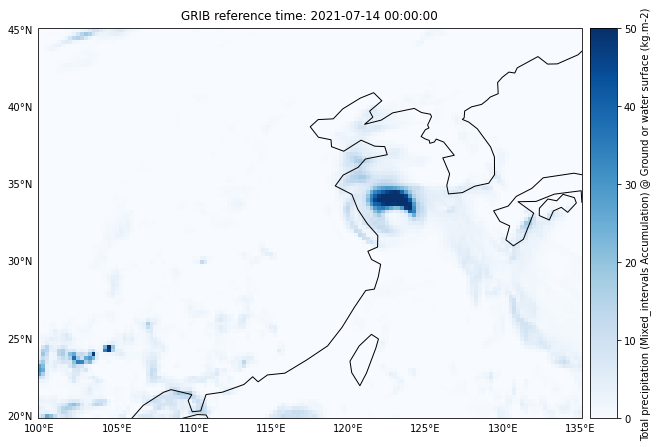
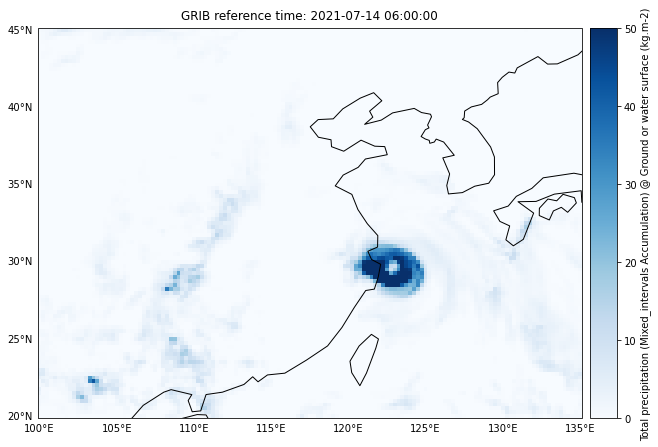
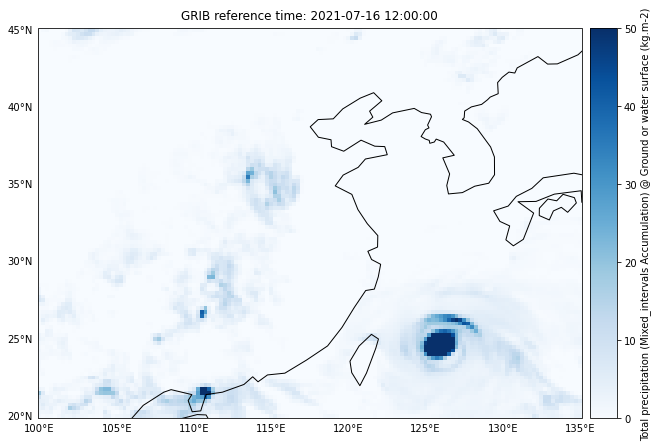
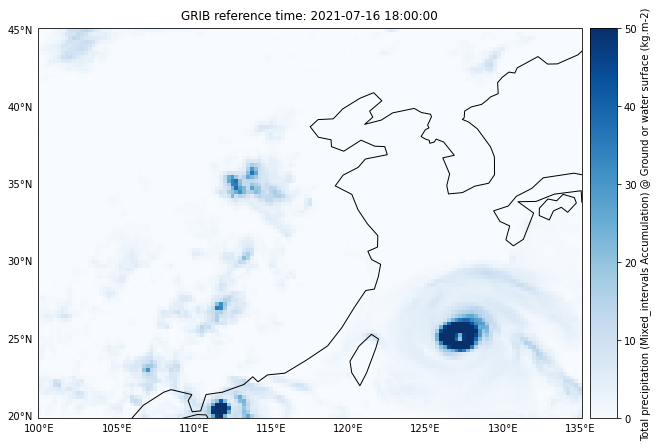
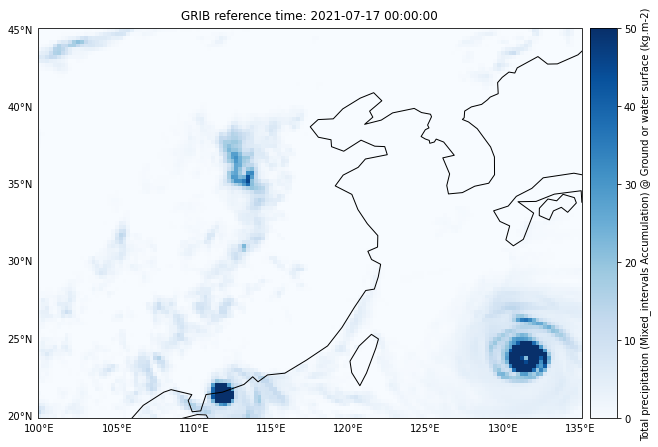
...
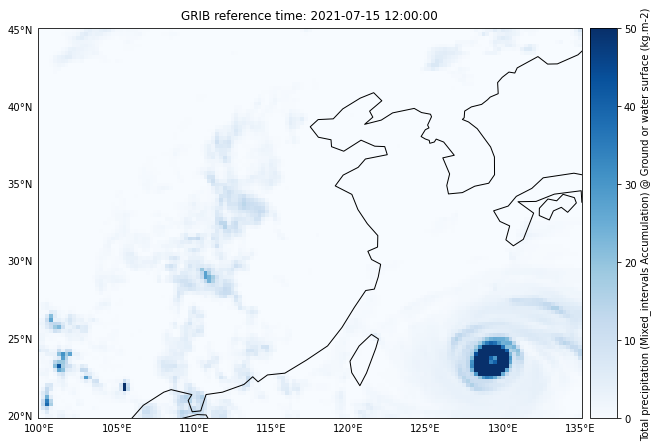
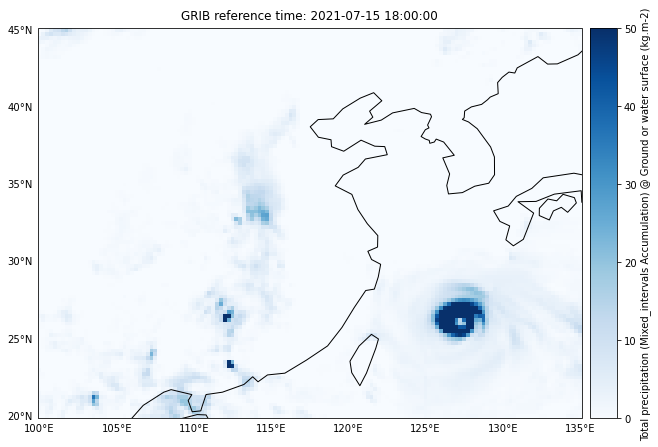
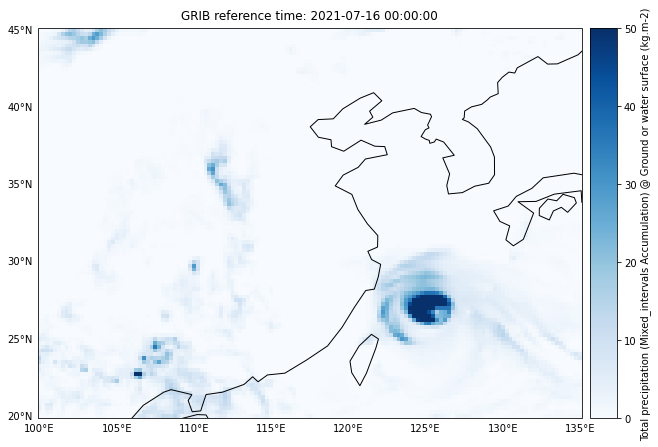
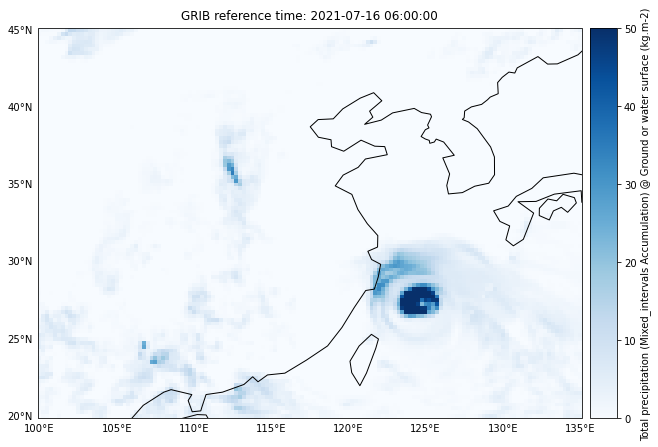
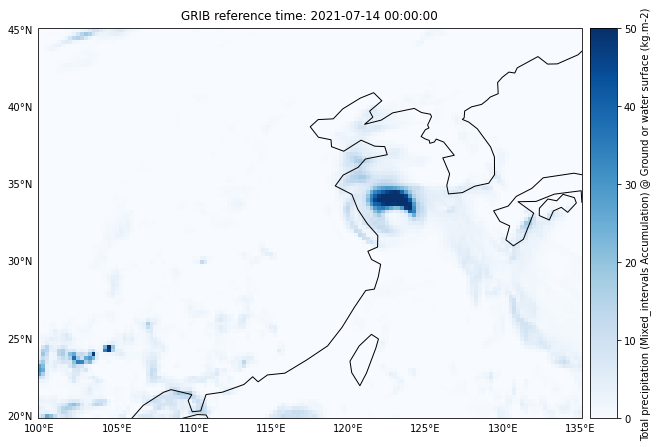

In [22]:
gvds = gv.Dataset(clipped)
ensemble = gvds.to(gv.Image, ['lon', 'lat'], 'Total_precipitation_surface_Mixed_intervals_Accumulation')

gv.output(ensemble.opts(cmap='Blues', colorbar=True, fig_size=270, backend='matplotlib') * gf.coastline(),
          backend='matplotlib')

# Conclusions

## 7.20 rain event had distinctive scale ~300km (1-2 Rossby radii, ice fall distance, ...?) 

## Event of that scale was model-predicted far in advance
### location was uncertain: warn via 'outlook' maps as at [SPC](https://www.spc.noaa.gov/products/outlook/)

## Probably stretched hydrostatic models beyond validity
### Do they properly account for moisture mass including condensate and lost vapor? 

## Does *nature* have a qualitatively different phenomenon at that scale? 
### MAUL, [Bryan and Fritsch 2000](https://journals.ametsoc.org/view/journals/bams/81/6/1520-0477_2000_081_1287_maitss_2_3_co_2.xml). Might I please get [these soundings]()?

## Attribution is hard, even with diverse ensemble (like leadtime ensemble)
### Extreme event selection upstream of study makes all factors correlated
### Only model experiments with mech denial/ i.c. surgery can address causality finally
#### well-forecast case makes that straightforward, though

[Back to Outline](#Outline)

# My Grand-parents in about 1930 
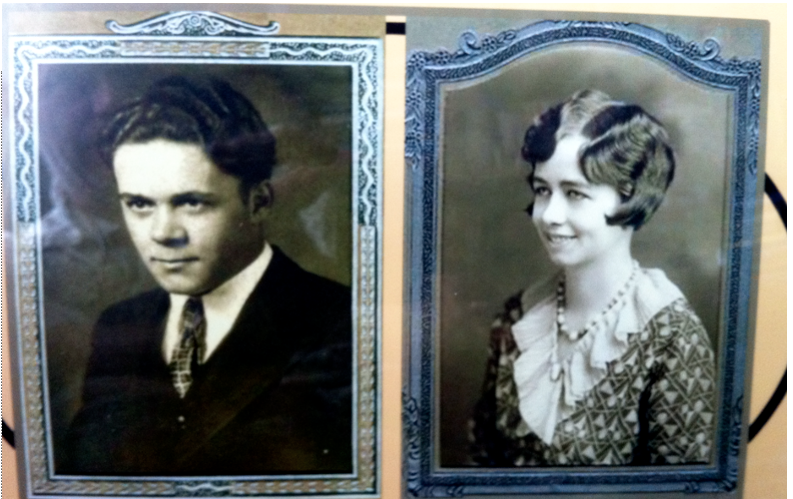

# Their farm, destroyed by tornado in 2011: 
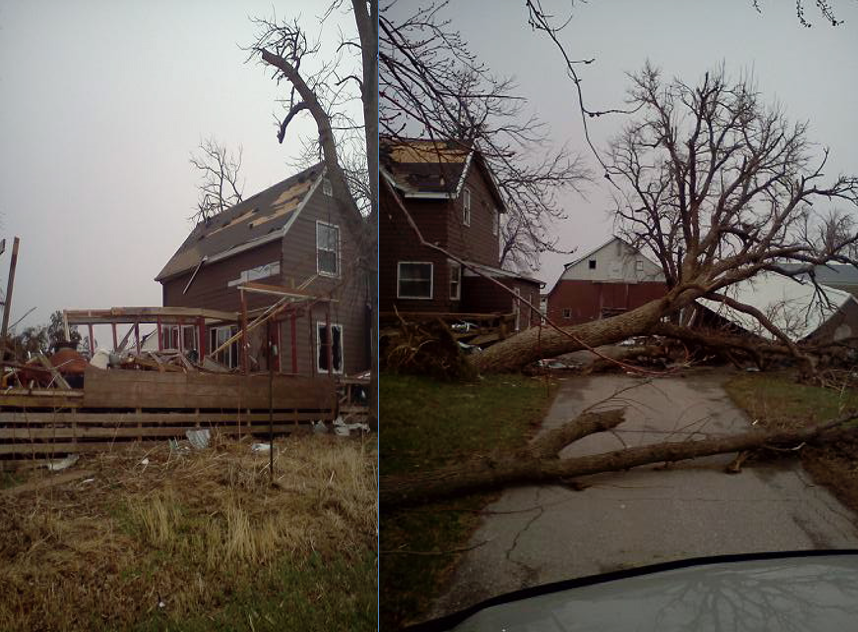

# 1-day "outlook": P(tornado within 25 miles)
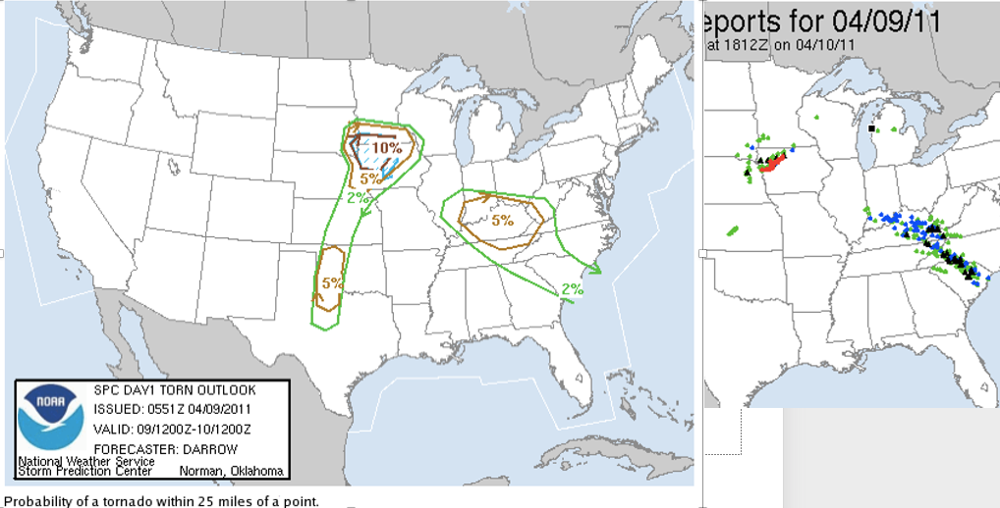